In [ ]:
# Import the required libraries & modules
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import warnings
# Suppress all warnings
warnings.filterwarnings("ignore")


In [ ]:
import pandas as pd
df = pd.read_excel('GBC.xlsx')
gbc_patients = df

In [ ]:
categorical_columns = [
    'Thyroidism', 'HTN', 'Family_cancer_history', 'ECOG_final', 'Gall_stone_final', 'Pathology', 'Tumour_grade_final',
    'Cancer_presentation_final', 'Tumour_stage_final', 'Mets_site_final', 'Surgery_final', 'Treatment_final','GENDER',
    'Diabetes_final','Status'
]

numerical_features = ['AGE', 'BMI_DETAILS', 'BILIRUBIN_CONJUGATED',
                      'BILIRUBIN_UNCONJUGATED', 'BILIRUBIN_TOTAL', 'AST_SGOT',
                      'ALT_SGPT', 'ALK_PHOS_ALP', 'GAMMA_GT', 'ALBUMIN']


# Drop all columns except the specified ones
gbc_patients = gbc_patients[categorical_columns + numerical_features]


In [ ]:
import pandas as pd

# Assuming the data is stored in a DataFrame called df
# Combine "Alive" and "Live" into "Alive"
gbc_patients['Status'] = gbc_patients['Status'].replace({'Live': 'Alive'})

# Filter to retain only "Dead" and "Alive" categories
gbc_patients = gbc_patients[gbc_patients['Status'].isin(['Dead', 'Alive'])]


In [ ]:
categorical_columns = [
    'Thyroidism', 'HTN', 'Family_cancer_history', 'ECOG_final', 'Gall_stone_final', 'Pathology', 'Tumour_grade_final',
    'Cancer_presentation_final', 'Tumour_stage_final', 'Mets_site_final', 'Surgery_final', 'Treatment_final','GENDER',
    'Diabetes_final','Status'
]

# Fill missing values with "Unknown"
gbc_patients[categorical_columns] = gbc_patients[categorical_columns].fillna('Unknown')

# Replace "Not known" with "Unknown"
gbc_patients[categorical_columns] = gbc_patients[categorical_columns].replace('Not known', 'Unknown')


In [ ]:
# List of categories to keep
categories_to_keep = ['Adenocarcinoma', 'Adenosquamous carcinoma', 'Neuroendocrine carcinoma']

# Replace categories other than those to keep with "Others"
gbc_patients['Pathology'] = gbc_patients['Pathology'].where(gbc_patients['Pathology'].isin(categories_to_keep), 'Others')

In [ ]:
# List of categories to keep
gbc_patients['Mets_site_final'] = gbc_patients['Mets_site_final'].replace(['Liver', 'Liver & Lungs', 'Liver & Bone'], 'Liver or Liver+others(lungs,bones)')


# List of categories to keep
categories_to_keep = ['Not applicable','Liver or Liver+others(lungs,bones)', 'Peritoneum & Omentum', 'Lungs']

# Replace categories other than those to keep with "Others"
gbc_patients['Mets_site_final'] = gbc_patients['Mets_site_final'].where(gbc_patients['Mets_site_final'].isin(categories_to_keep), 'Others')


gbc_patients['Mets_site_final'].value_counts()


,count
Mets_site_final,
Not applicable,208
"Liver or Liver+others(lungs,bones)",174
Others,83
Peritoneum & Omentum,36
Lungs,19


In [ ]:
#problamatic Names therefore changing the names of a few categories

# Replace the specific values in the 'Mets_site_final' column
gbc_patients['Mets_site_final'] = gbc_patients['Mets_site_final'].replace({
    'Liver or Liver+others(lungs,bones)': 'Liver and Near organs',
    'Peritoneum & Omentum': 'Peritoneum and Omentum'
})

# Display the updated DataFrame
print(gbc_patients['Mets_site_final'].value_counts())


Mets_site_final
Not applicable            208
Liver and Near organs     174
Others                     83
Peritoneum and Omentum     36
Lungs                      19
Name: count, dtype: int64


In [ ]:
from tabulate import tabulate

# Define numerical features
numerical_features = ['AGE', 'BMI_DETAILS', 'BILIRUBIN_CONJUGATED', 'BILIRUBIN_UNCONJUGATED',
                      'BILIRUBIN_TOTAL', 'AST_SGOT', 'ALT_SGPT', 'ALK_PHOS_ALP', 'GAMMA_GT', 'ALBUMIN']

# Initialize an empty dictionary to store summary statistics tables for each feature
summary_tables = {}

# Loop through each numerical feature
for feature in numerical_features:
    # Calculate summary statistics grouped by 'Status'
    summary_stats = gbc_patients.groupby('Status')[feature].describe()

    # Convert the summary statistics DataFrame to a more visually appealing table
    summary_table = summary_stats.reset_index()
    summary_table = summary_table.rename(columns={'count': 'Count', 'mean': 'Mean', 'std': 'Standard Deviation',
                                                  'min': 'Min', '25%': '25%', '50%': 'Median', '75%': '75%',
                                                  'max': 'Max'})
    summary_table.set_index('Status', inplace=True)

    # Store the summary table in the dictionary
    summary_tables[feature] = summary_table

# Print the summary statistics tables for each numerical feature
for feature, summary_table in summary_tables.items():
    print(f"\nSummary Statistics for '{feature}':\n")
    print(tabulate(summary_table, headers='keys', tablefmt='fancy_grid'))



Summary Statistics for 'AGE':

╒══════════╤═════════╤═════════╤══════════════════════╤═══════╤═══════╤══════════╤═══════╤═══════╕
│ Status   │   Count │    Mean │   Standard Deviation │   Min │   25% │   Median │   75% │   Max │
╞══════════╪═════════╪═════════╪══════════════════════╪═══════╪═══════╪══════════╪═══════╪═══════╡
│ Alive    │      60 │ 58.5333 │              11.3458 │    23 │    52 │       60 │ 67.25 │    82 │
├──────────┼─────────┼─────────┼──────────────────────┼───────┼───────┼──────────┼───────┼───────┤
│ Dead     │     460 │ 58.1609 │              10.4758 │    20 │    51 │       59 │ 65    │    87 │
╘══════════╧═════════╧═════════╧══════════════════════╧═══════╧═══════╧══════════╧═══════╧═══════╛

Summary Statistics for 'BMI_DETAILS':

╒══════════╤═════════╤═════════╤══════════════════════╤═══════╤═════════╤══════════╤═════════╤═══════╕
│ Status   │   Count │    Mean │   Standard Deviation │   Min │     25% │   Median │     75% │   Max │
╞══════════╪═════════╪═══════

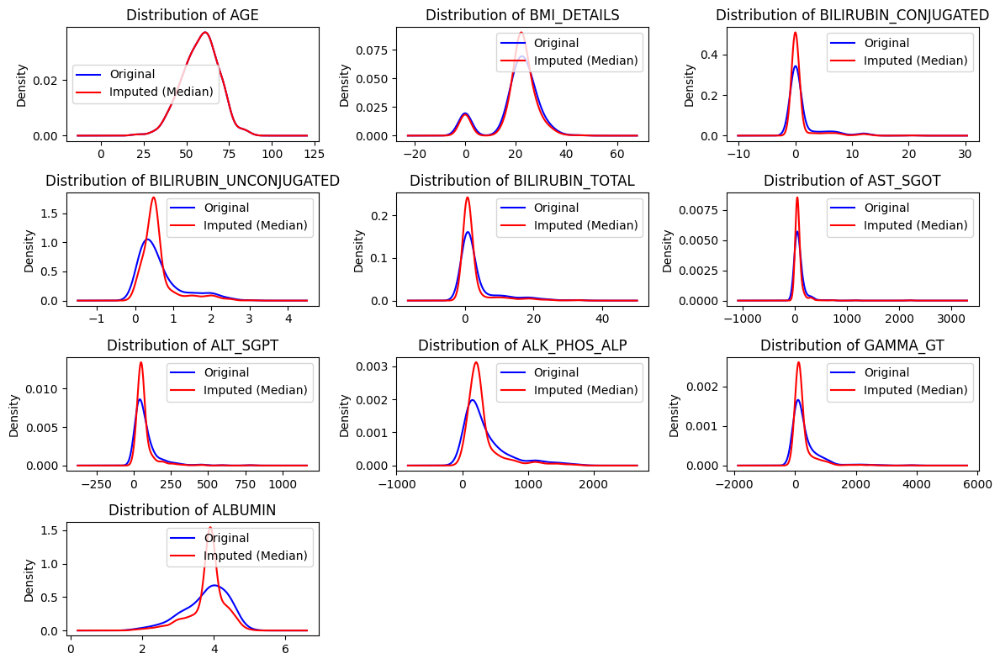

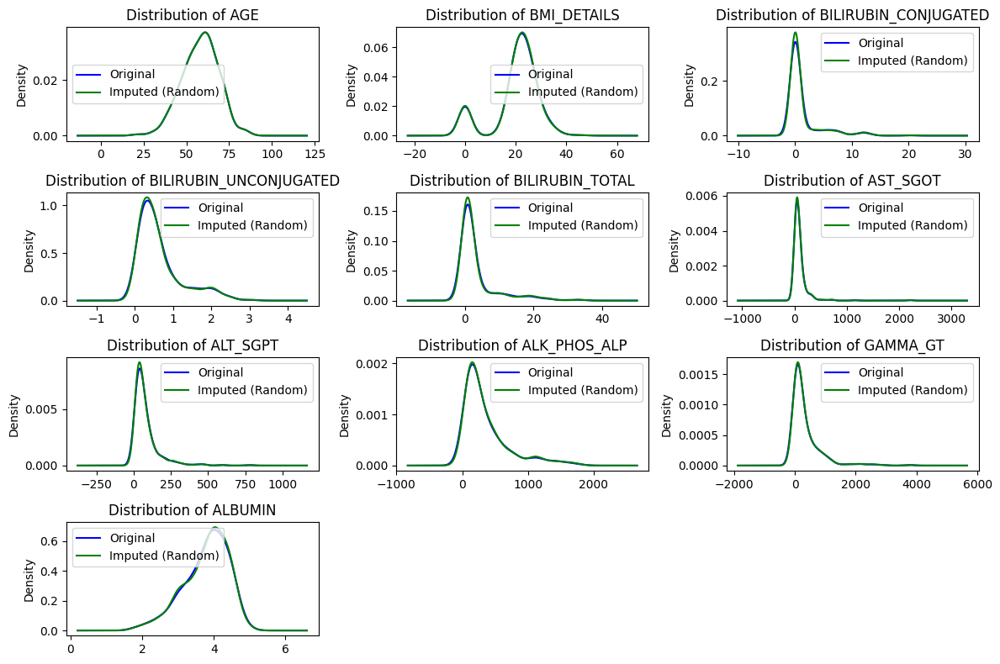

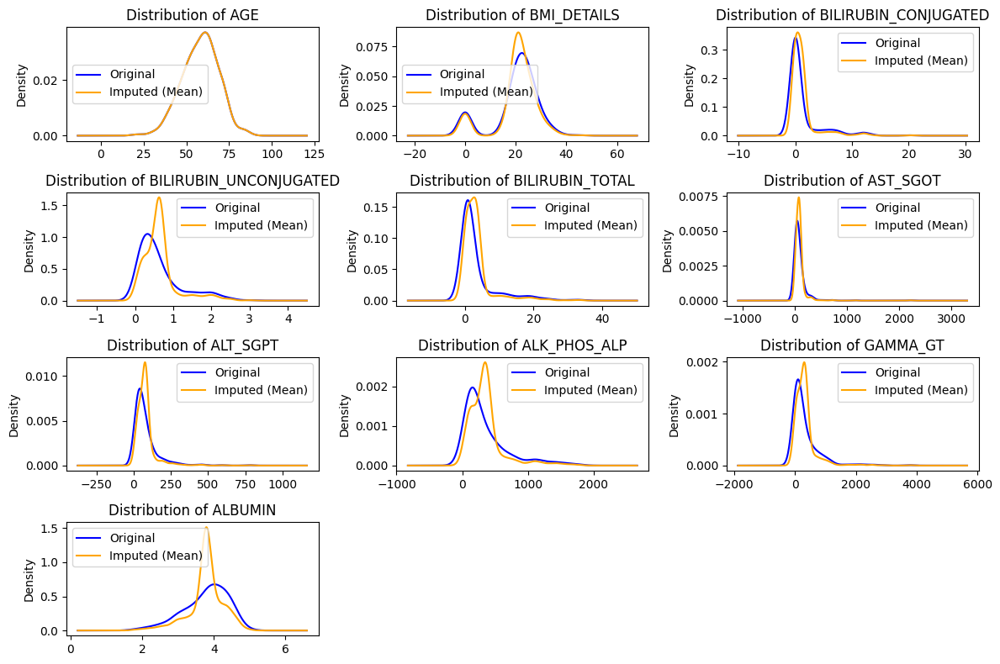

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

def impute_numerical(gbc_patients, variables, method='median', random_state=None):
    imputed_values = {}  # To store the imputed values for each variable

    num_variables = len(variables)
    num_rows = (num_variables + 2) // 3  # Calculate the number of subplot rows

    plt.figure(figsize=(12, 8))
    for i, variable in enumerate(variables, 1):
        plt.subplot(num_rows, 3, i)  # Adjust subplot creation
        gbc_patients[variable].plot(kind='kde', label='Original', color='blue')

        if method == 'median':
            median = gbc_patients[variable].median()
            gbc_patients[variable + "_median"] = gbc_patients[variable].fillna(median)
            gbc_patients[variable + "_median"].plot(kind='kde', label='Imputed (Median)', color='red')
            imputed_values[variable] = median
        elif method == 'random':
            gbc_patients[variable + "_random"] = gbc_patients[variable]
            random_sample = gbc_patients[variable].dropna().sample(gbc_patients[variable].isnull().sum(), random_state=random_state)
            random_sample.index = gbc_patients[gbc_patients[variable].isnull()].index
            gbc_patients.loc[gbc_patients[variable].isnull(), variable + '_random'] = random_sample.values
            imputed_values[variable] = random_sample.values
            gbc_patients[variable + "_random"].plot(kind='kde', label='Imputed (Random)', color='green')
        elif method == 'mean':
            mean = gbc_patients[variable].mean()
            gbc_patients[variable + "_mean"] = gbc_patients[variable].fillna(mean)
            gbc_patients[variable + "_mean"].plot(kind='kde', label='Imputed (Mean)', color='orange')
            imputed_values[variable] = mean

        plt.title(f'Distribution of {variable}')
        plt.legend()

    plt.tight_layout()
    plt.show()

    return imputed_values

# Example usage:
variables_to_impute = ['AGE', 'BMI_DETAILS', 'BILIRUBIN_CONJUGATED', 'BILIRUBIN_UNCONJUGATED',
                      'BILIRUBIN_TOTAL', 'AST_SGOT', 'ALT_SGPT', 'ALK_PHOS_ALP', 'GAMMA_GT', 'ALBUMIN']
# Impute using median values
imputed_values_median = impute_numerical(gbc_patients, variables_to_impute, method='median')
#print("Imputed Values using Median:")
#print(imputed_values_median)

# Impute using random values
imputed_values_random = impute_numerical(gbc_patients, variables_to_impute, method='random', random_state=0)
#print("\nImputed Values using Random:")
#print(imputed_values_random)

# Impute using mean values
imputed_values_mean = impute_numerical(gbc_patients, variables_to_impute, method='mean')
#print("\nImputed Values using Mean:")
#print(imputed_values_mean)


In [ ]:
# List of columns to drop
columns_to_drop = ['AGE', 'BMI_DETAILS', 'BILIRUBIN_CONJUGATED',
       'BILIRUBIN_UNCONJUGATED', 'BILIRUBIN_TOTAL', 'AST_SGOT', 'ALT_SGPT',
       'ALK_PHOS_ALP', 'GAMMA_GT', 'ALBUMIN', 'AGE_median',
       'BMI_DETAILS_median', 'BILIRUBIN_CONJUGATED_median',
       'BILIRUBIN_UNCONJUGATED_median', 'BILIRUBIN_TOTAL_median',
       'AST_SGOT_median', 'ALT_SGPT_median', 'ALK_PHOS_ALP_median',
       'GAMMA_GT_median', 'ALBUMIN_median', 'AGE_mean',
       'BMI_DETAILS_mean', 'BILIRUBIN_CONJUGATED_mean',
       'BILIRUBIN_UNCONJUGATED_mean', 'BILIRUBIN_TOTAL_mean', 'AST_SGOT_mean',
       'ALT_SGPT_mean', 'ALK_PHOS_ALP_mean', 'GAMMA_GT_mean', 'ALBUMIN_mean']
# Dropping the columns
gbc_patients = gbc_patients.drop(columns=columns_to_drop)

gbc_patients.shape

(520, 25)

In [ ]:
new_column_names = {
    'Thyroidism': 'Thyroid',
    'HTN': 'Hypertension',
    'ALK_PHOS_ALP_random': 'Alkaline Phosphatase',
    #'GAMMA GT': 'Gamma-glutamyl-transferase',
    'ALBUMIN_random': 'ALBUMIN',
    'ECOG_final': 'ECOG score',
    'AGE_random':'Age',
    'Gall_stone_final':'Gallstones',
    'Tumour_stage_final': 'Tumour stage',
    'Tumour_grade_final': 'Tumour grade',
    'Mets_site_final': 'Metastasis site',
    'Surgery_final': 'Surgery',
    'Treatment_final':'Treatment administered',
    'Diabetes_final':'Diabetes',
    'BMI_DETAILS_random': 'BMI-BODY MASS INDEX',
    'GAMMA_GT_random': 'Gamma-glutamyl-transferase',
    'Cancer_presentation_final':'Cancer presentation',
    'BILIRUBIN_CONJUGATED_random': 'BILIRUBIN CONJUGATED',
    'BILIRUBIN_UNCONJUGATED_random':'BILIRUBIN UNCONJUGATED',
    'BILIRUBIN_TOTAL_random':'BILIRUBIN TOTAL',
    'AST_SGOT_random':'AST-SGOT',
    'ALT_SGPT_random':'ALT-SGPT',
    'Family_cancer_history': 'Family cancer history'

}


gbc_patients.rename(columns=new_column_names, inplace=True)

In [ ]:
gbc_patients.to_excel('gbc_cleaned_data.xlsx', index=False)

In [ ]:
gbc_patients = pd.read_excel("gbc_cleaned_data.xlsx")

In [ ]:
#Encode "Status" as 0 for "Dead" and 1 for "Alive"
gbc_patients['Status']=gbc_patients['Status'].apply(lambda x: 0 if x == 'Dead' else 1)


In [ ]:
import pandas as pd

# Define the categorical columns
categorical_columns = [
    'Thyroid', 'Hypertension', 'Family cancer history', 'ECOG score', 'Gallstones', 'Pathology', 'Tumour grade',
    'Cancer presentation', 'Tumour stage', 'Metastasis site', 'Surgery', 'Treatment administered','GENDER',
    'Diabetes'
]

numerical_features = ['Age', 'BMI-BODY MASS INDEX', 'BILIRUBIN CONJUGATED',
       'BILIRUBIN UNCONJUGATED', 'BILIRUBIN TOTAL', 'AST-SGOT', 'ALT-SGPT',
       'Alkaline Phosphatase', 'Gamma-glutamyl-transferase', 'ALBUMIN']


# Perform one-hot encoding on categorical variables
# gbc_encoded = pd.get_dummies(gbc_patients, columns=categorical_columns, drop_first=True)

from sklearn.preprocessing import OneHotEncoder
enc = OneHotEncoder(sparse_output=False).fit(gbc_patients[categorical_columns])
gbc_encoded = enc.transform(gbc_patients[categorical_columns])

all_categories = []
for col, x in zip(categorical_columns, enc.categories_):
    for y in x:
        all_categories.append(col + '_' + y)

gbc_encoded = pd.concat([
    gbc_patients[numerical_features].reset_index(drop=True),
    pd.DataFrame(gbc_encoded, columns=all_categories).reset_index(drop=True)
], axis=1)


#Encode "Status" as 0 for "Dead" and 1 for "Alive"
gbc_encoded['Status'] = gbc_patients['Status'].reset_index(drop=True)

In [ ]:
gbc_encoded.to_excel('gbc_encoded_final.xlsx',index=False)

In [ ]:
df_work = gbc_encoded.copy()

In [ ]:
!pip install catboost

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.2/99.2 MB 9.3 MB/s eta 0:00:00


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 106, number of negative: 372
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000584 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1155
[LightGBM] [Info] Number of data points in the train set: 478, number of used features: 59
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.221757 -> initscore=-1.255455
[LightGBM] [Info] Start training from score -1.255455
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain

<Figure size 1000x800 with 0 Axes>

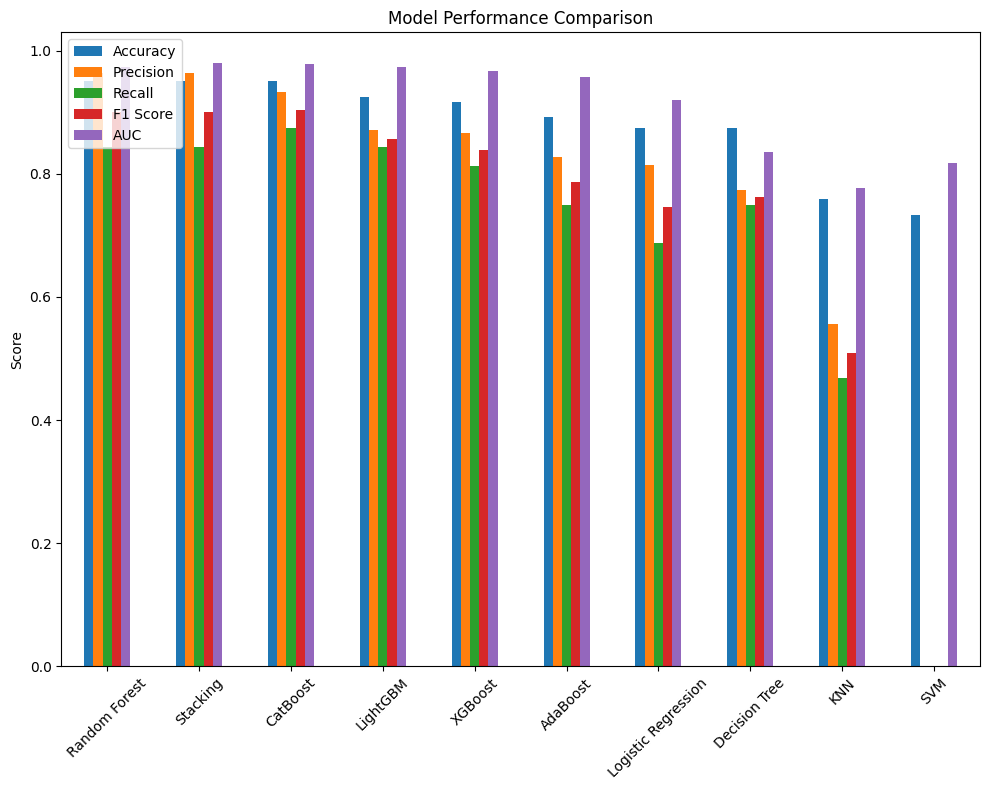

Model evaluation results:
                     Accuracy  Precision   Recall  F1 Score       AUC  \
Logistic Regression  0.875000   0.814815  0.68750  0.745763  0.919389   
Random Forest        0.950000   0.964286  0.84375  0.900000  0.973899   
SVM                  0.733333   0.000000  0.00000  0.000000  0.817827   
KNN                  0.758333   0.555556  0.46875  0.508475  0.776456   
Decision Tree        0.875000   0.774194  0.75000  0.761905  0.835227   
AdaBoost             0.891667   0.827586  0.75000  0.786885  0.958097   
CatBoost             0.950000   0.933333  0.87500  0.903226  0.978338   
XGBoost              0.916667   0.866667  0.81250  0.838710  0.966619   
LightGBM             0.925000   0.870968  0.84375  0.857143  0.973722   
Stacking             0.950000   0.964286  0.84375  0.900000  0.980824   

                     Training Time (s)  Testing Time (s)  
Logistic Regression           2.538839          0.004397  
Random Forest                 0.429281          0.04

In [ ]:
from imblearn.over_sampling import SMOTE
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from catboost import CatBoostClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from sklearn.ensemble import StackingClassifier
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Splitting the data into features and target
X = df_work.drop('Status', axis=1)
y = df_work['Status']

# Apply SMOTE to balance the classes
smote = SMOTE(sampling_strategy=0.3, random_state=42)
X_resampled, y_resampled = smote.fit_resample(X, y)

# Splitting the resampled data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.2, random_state=42)

# Adjusting the column names according to the dataset
# numerical_cols = ['AGE', 'BMI_DETAILS', 'BILIRUBIN_CONJUGATED',
#        'BILIRUBIN_UNCONJUGATED', 'BILIRUBIN_TOTAL', 'AST_SGOT', 'ALT_SGPT',
#        'ALK_PHOS_ALP', 'GAMMA_GT', 'ALBUMIN']

# # Standardizing the numerical features
# scaler = StandardScaler()
# X_train[numerical_cols] = scaler.fit_transform(X_train[numerical_cols])
# X_test[numerical_cols] = scaler.transform(X_test[numerical_cols])

# Defining the models
models = {
    'Logistic Regression': LogisticRegression(max_iter=1000),
    'Random Forest': RandomForestClassifier(),
    'SVM': SVC(probability=True),
    'KNN': KNeighborsClassifier(),
    #'Naive Bayes': GaussianNB(),
    'Decision Tree': DecisionTreeClassifier(),
    'AdaBoost': AdaBoostClassifier(),
    'CatBoost': CatBoostClassifier(verbose=0),
    'XGBoost': XGBClassifier(eval_metric='logloss'),
    'LightGBM': LGBMClassifier(),
}

# Adding Stacking Classifier
base_learners = [
    ('rf', RandomForestClassifier()),
    ('svc', SVC(probability=True)),
    ('knn', KNeighborsClassifier())
]
models['Stacking'] = StackingClassifier(estimators=base_learners, final_estimator=LogisticRegression())

import time

# Function to evaluate model and measure training and testing time
def evaluate_model_with_time(model, X_train, X_test, y_train, y_test):
    start_train_time = time.time()
    model.fit(X_train, y_train)
    end_train_time = time.time()
    training_time = end_train_time - start_train_time

    start_test_time = time.time()
    y_pred = model.predict(X_test)
    end_test_time = time.time()
    testing_time = end_test_time - start_test_time

    y_proba = model.predict_proba(X_test)[:, 1]
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred)
    recall = recall_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)
    auc = roc_auc_score(y_test, y_proba)
    return accuracy, precision, recall, f1, auc, training_time, testing_time

# Evaluating each model and measuring training and testing time
results = {}
for name, model in models.items():
    results[name] = evaluate_model_with_time(model, X_train, X_test, y_train, y_test)

# Converting results to DataFrame for easier visualization
results_df = pd.DataFrame(results, index=['Accuracy', 'Precision', 'Recall', 'F1 Score', 'AUC', 'Training Time (s)', 'Testing Time (s)']).T

# Plotting the performance scores
plt.figure(figsize=(10, 8), facecolor='white')
results_df.drop(['Training Time (s)', 'Testing Time (s)'], axis=1).sort_values(by='Accuracy', ascending=False).plot(kind='bar', figsize=(10, 8))
plt.title('Model Performance Comparison')
plt.ylabel('Score')
plt.xticks(rotation=45)
plt.legend(loc='upper left')
plt.tight_layout()
#plt.savefig('model_performance_comparison.png')
plt.show()

# Displaying the model evaluation results including training and testing time
print('Model evaluation results:')
print(results_df)


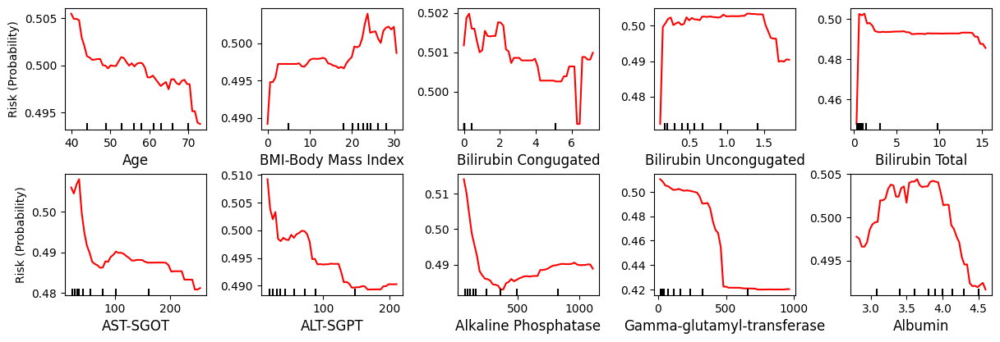

In [ ]:
#plot for paper
import matplotlib.pyplot as plt
from sklearn.inspection import PartialDependenceDisplay
from sklearn.ensemble import GradientBoostingClassifier
from imblearn.over_sampling import SMOTE
import pandas as pd

# Assuming you have your data loaded into a pandas DataFrame 'df_work'

# Splitting the data into features and target
X = df_work.drop('Status', axis=1)
y = df_work['Status']

# Apply SMOTE to address class imbalance
smote = SMOTE(sampling_strategy=1)  # 30% oversampling of the minority class
X_resampled, y_resampled = smote.fit_resample(X, y)

# Fit a model on the resampled data
#clf = XGBClassifier().fit(X_resampled, y_resampled)
clf=RandomForestClassifier(random_state=42).fit(X_resampled, y_resampled)

# Define the features to plot

features = ['Age', 'BMI-Body Mass Index', 'Bilirubin Congugated',
       'Bilirubin Uncongugated', 'Bilirubin Total', 'AST-SGOT', 'ALT-SGPT',
       'Alkaline Phosphatase', 'Gamma-glutamyl-transferase', 'Albumin']

# Select the desired number of features to plot (8 in this case)
num_features_to_plot = 10

# Create a 5x2 subplot grid
fig, axs = plt.subplots(2, 5, figsize=(12, 4))

# Hide the extra axes that won't be used (for 8 plots)
for ax in axs.flatten()[num_features_to_plot:]:
    ax.axis('off')  # Turn off ticks and labels

# Iterate over each feature and create a PDP plot on the first 8 axes
for i, feature in enumerate(features[:num_features_to_plot]):
    pdp_display = PartialDependenceDisplay.from_estimator(clf, X_resampled, [i], ax=axs[i // 5, i % 5], grid_resolution=50,line_kw={"color": "red"})
    plt.xlabel(features[i], fontsize=12)
    if(i==0 or i==5):
      plt.ylabel('Risk (Probability)', fontsize=10)
    else:
      plt.ylabel('')
    #axs[i // 2, i % 2].set_title(f'PDP for {feature}', fontsize=14)
    #axs[i // 5, i % 5].set_ylabel('Predicted Risk to Death Probability', fontsize=12)  # Set y-axis label

plt.tight_layout(pad=0.1)  # Adjust subplot layout with equal spacing
plt.savefig('final_pdp.png', dpi=400)
plt.show()


In [ ]:
df_work.columns

Index(['Age', 'BMI-BODY MASS INDEX', 'BILIRUBIN CONJUGATED',
       'BILIRUBIN UNCONJUGATED', 'BILIRUBIN TOTAL', 'AST-SGOT', 'ALT-SGPT',
       'Alkaline Phosphatase', 'Gamma-glutamyl-transferase', 'ALBUMIN',
       'Thyroid_Hypothyroidism', 'Thyroid_No', 'Thyroid_Unknown',
       'Hypertension_No', 'Hypertension_Unknown', 'Hypertension_Yes',
       'Family cancer history_No', 'Family cancer history_Unknown',
       'Family cancer history_Yes', 'ECOG score_0', 'ECOG score_1',
       'ECOG score_2', 'ECOG score_3', 'ECOG score_4', 'ECOG score_Unknown',
       'Gallstones_No', 'Gallstones_Polyp', 'Gallstones_Unknown',
       'Gallstones_Yes', 'Pathology_Adenocarcinoma',
       'Pathology_Adenosquamous carcinoma',
       'Pathology_Neuroendocrine carcinoma', 'Pathology_Others',
       'Tumour grade_Grade 1', 'Tumour grade_Grade 2', 'Tumour grade_Grade 3',
       'Tumour grade_Grade 4', 'Tumour grade_Grade X', 'Tumour grade_Unknown',
       'Cancer presentation_Incidental',
       'Cancer 

In [ ]:
import pandas as pd
import numpy as np
import warnings
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.inspection import partial_dependence
from scipy.stats import pearsonr

# Standard model imports available in most environments
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, StackingClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier

# --- Model Definitions (CLEANED for maximum compatibility) ---
# NOTE: XGBoost, LightGBM, and CatBoost are excluded here to prevent run-time errors.
models = {
    'Logistic Regression': LogisticRegression(max_iter=1000, random_state=42),
    'Random Forest': RandomForestClassifier(random_state=42),
    'SVM': SVC(probability=True, random_state=42),
    'KNN': KNeighborsClassifier(),
    'Decision Tree': DecisionTreeClassifier(random_state=42),
    'AdaBoost': AdaBoostClassifier(random_state=42),
}
base_learners = [
    ('rf', RandomForestClassifier(random_state=42)),
    ('svc', SVC(probability=True, random_state=42)),
    ('knn', KNeighborsClassifier())
]
models['Stacking'] = StackingClassifier(estimators=base_learners, final_estimator=LogisticRegression(random_state=42))

# --- Feature List ---
# IMPORTANT: Ensure these names exactly match your DataFrame columns.
features = ['Age', 'BMI-BODY MASS INDEX', 'BILIRUBIN CONJUGATED',
            'BILIRUBIN UNCONJUGATED', 'BILIRUBIN TOTAL', 'AST-SGOT', 'ALT-SGPT',
            'Alkaline Phosphatase', 'Gamma-glutamyl-transferase', 'ALBUMIN']

# --- Calculation Logic ---
all_correlation_matrices = {}
warnings.filterwarnings('ignore')
all_successful_models = set(models.keys()) # Start with all models

print("Starting PDP correlation analysis and filtering...")

for feature in features:
    pdp_data_list = []
    model_names_fitted = []

    for name, model in models.items():
        try:
            # Fit model on training data (Crucial step)
            model.fit(X_train, y_train)

            # Calculate Partial Dependence
            pd_results = partial_dependence(
                model, X_resampled, features=[feature], kind='average', grid_resolution=50
            )
            print(pd_results)
            pdp_data_list.append(pd_results.average[0])
            model_names_fitted.append(name)
        except Exception:
            # If any step fails, this model is excluded for this feature
            pass

    # Update the set of models that have successfully run for ALL features so far
    all_successful_models = all_successful_models.intersection(set(model_names_fitted))

    # Compute Correlation Matrix for successfully fitted models for this feature
    if len(model_names_fitted) >= 2:
        num_models = len(model_names_fitted)
        correlation_matrix = np.zeros((num_models, num_models))

        for i in range(num_models):
            for j in range(i, num_models):
                corr, _ = pearsonr(pdp_data_list[i], pdp_data_list[j])
                correlation_matrix[i, j] = correlation_matrix[j, i] = corr

        correlation_df = pd.DataFrame(correlation_matrix,
                                      index=model_names_fitted,
                                      columns=model_names_fitted)
        all_correlation_matrices[feature] = correlation_df


# --- Final Output Generation (Guaranteed NaN-Free) ---

final_model_list = sorted(list(all_successful_models)) # Final consistent list of models

if len(final_model_list) < 2:
    print("\n❌ Error: Fewer than two models successfully ran for ALL features. Cannot generate correlation table.")
else:
    # 1. Generate the Combined, Cleaned Correlation Table (CSV)
    combined_dfs = []
    for feature in features:
        if feature in all_correlation_matrices:
            df = all_correlation_matrices[feature]

            # Filter and reindex to the final consistent list
            df_filtered = df.reindex(index=final_model_list, columns=final_model_list)

            # Create MultiIndex structure
            combined_dfs.append(df_filtered.assign(Feature=feature).set_index('Feature', append=True).reorder_levels([1, 0]))

    cleaned_df = pd.concat(combined_dfs)
    cleaned_df.to_csv('pdp_correlation_matrices_CLEANED.csv')

    print("\n✅ All pairwise correlation matrices saved to pdp_correlation_matrices_CLEANED.csv")

    # 2. Generate the Summary Statistics Table (Printed Output)
    summary_data = []
    for feature in features:
        if feature in all_correlation_matrices:
            df = all_correlation_matrices[feature]
            df_valid = df.reindex(index=final_model_list, columns=final_model_list)

            # Extract upper triangle correlations from the valid models
            upper_triangle = df_valid.values[np.triu_indices(len(final_model_list), k=1)]

            summary_data.append({
                'Feature': feature,
                'Min Correlation': upper_triangle.min(),
                'Max Correlation': upper_triangle.max(),
                'Average Correlation': upper_triangle.mean()
            })

    summary_df = pd.DataFrame(summary_data).set_index('Feature')
    print("\n--- Correlation Summary Table (CLEANED) ---")
    print(summary_df.round(3))

Starting PDP correlation analysis and filtering...
{'grid_values': [array([40.        , 40.67346939, 41.34693878, 42.02040816, 42.69387755,
       43.36734694, 44.04081633, 44.71428571, 45.3877551 , 46.06122449,
       46.73469388, 47.40816327, 48.08163265, 48.75510204, 49.42857143,
       50.10204082, 50.7755102 , 51.44897959, 52.12244898, 52.79591837,
       53.46938776, 54.14285714, 54.81632653, 55.48979592, 56.16326531,
       56.83673469, 57.51020408, 58.18367347, 58.85714286, 59.53061224,
       60.20408163, 60.87755102, 61.55102041, 62.2244898 , 62.89795918,
       63.57142857, 64.24489796, 64.91836735, 65.59183673, 66.26530612,
       66.93877551, 67.6122449 , 68.28571429, 68.95918367, 69.63265306,
       70.30612245, 70.97959184, 71.65306122, 72.32653061, 73.        ])], 'average': array([[0.3571278 , 0.35678092, 0.35643407, 0.35608726, 0.35574049,
        0.35539376, 0.35504707, 0.35470041, 0.35435379, 0.35400722,
        0.35366068, 0.35331418, 0.35296773, 0.35262131, 0.3522

In [ ]:
upper_triangle

array([-0.04021793,  0.87951608,  0.81998539,  0.85351458, -0.82451276,
        0.90743015, -0.02243936,  0.28419379, -0.00128603, -0.27507688,
       -0.0134261 ,  0.84656228,  0.78815768, -0.85249591,  0.82126047,
        0.65290321, -0.99990772,  0.71357842, -0.65818696,  0.98942625,
       -0.71855682])

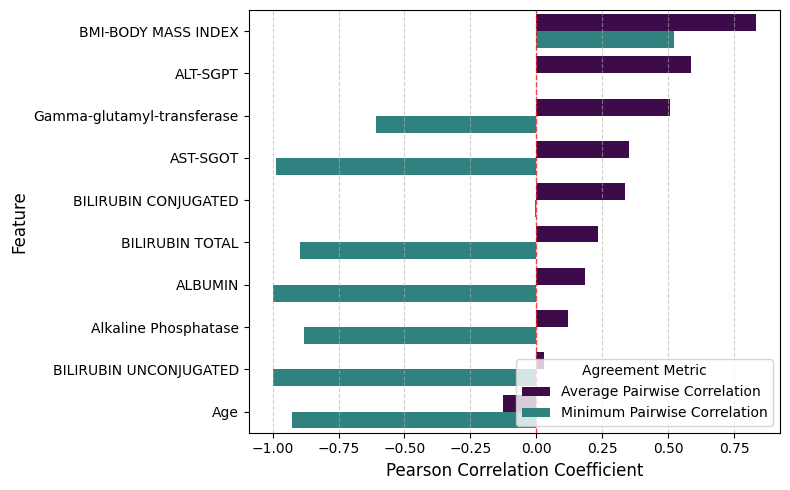

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# 1. Recreate the Summary DataFrame from the last successful calculation (NaNs treated as 0)
data = {
    'Min Correlation': [-0.928, 0.523, -0.003, -1.000, -0.898, -0.986, 0.000, -0.880, -0.608, -1.000],
    'Max Correlation': [0.999, 1.000, 0.999, 0.961, 0.998, 1.000, 0.993, 0.963, 0.949, 0.987],
    'Average Correlation': [-0.125, 0.833, 0.337, 0.029, 0.235, 0.353, 0.586, 0.122, 0.509, 0.184]
}
index = ['Age', 'BMI-BODY MASS INDEX', 'BILIRUBIN CONJUGATED', 'BILIRUBIN UNCONJUGATED',
         'BILIRUBIN TOTAL', 'AST-SGOT', 'ALT-SGPT', 'Alkaline Phosphatase',
         'Gamma-glutamyl-transferase', 'ALBUMIN']
df_summary = pd.DataFrame(data, index=index)
df_summary.index.name = 'Feature'

# 2. Prepare Data for Plotting (Selecting only Min and Average)
# Sorted by Average Correlation
df_plot = df_summary[['Min Correlation', 'Average Correlation']].sort_values(by='Average Correlation', ascending=False)
df_plot = df_plot.rename(columns={'Min Correlation': 'Minimum Pairwise Correlation',
                                  'Average Correlation': 'Average Pairwise Correlation'})

plot_data = df_plot.reset_index().melt(id_vars='Feature',
                                        value_vars=['Average Pairwise Correlation', 'Minimum Pairwise Correlation'],
                                        var_name='Metric',
                                        value_name='Correlation Value')
feature_order = df_plot.index.tolist()

# 3. Generating and Saving the Plot as PDF
plt.figure(figsize=(8, 5))
sns.barplot(data=plot_data,
            x='Correlation Value',
            y='Feature',
            hue='Metric',
            palette = ['#440154', '#21908d'],
            order=feature_order)

# Add enhancements for presentation
plt.axvline(0, color='red', linestyle='--', linewidth=1, alpha=0.7)
plt.xlabel('Pearson Correlation Coefficient', fontsize=12)
plt.ylabel('Feature', fontsize=12)
#plt.title('Feature-Wise Agreement: Average vs. Minimum PDP Correlation Across Models (NaN=0)', fontsize=14)
plt.legend(title='Agreement Metric', loc='lower right')
plt.grid(axis='x', linestyle='--', alpha=0.6)
plt.tight_layout()

# Save the figure as a high-quality PDF file
plt.savefig('pdp_agreement_bar_plot_NaN_0.pdf')

In [ ]:
!pip install interpret
!pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.0/4.0 MB 71.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.2/45.2 kB 3.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.6/16.6 MB 45.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.6/7.6 MB 72.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 70.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 52.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 780.1/780.1 kB 34.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.7/101.7 kB 7.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 50.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 228.0/228.0 kB 14.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 264.7/264.7 kB 21.0 MB/s eta 0:00:00
  Created wheel for dash-cytoscape: filename=dash_cytoscape-1.0.2-py3-none-any.whl size=40

In [ ]:
from interpret.blackbox import LimeTabular
from interpret import show

In [ ]:
import pandas as pd
import numpy as np
from lime.lime_tabular import LimeTabularExplainer
from sklearn.model_selection import train_test_split
from xgboost import XGBClassifier
from imblearn.over_sampling import SMOTE
import matplotlib.pyplot as plt

# Assuming you have your data loaded into a pandas DataFrame 'df_work'

# Split the data into features (X) and target (y)
X = df_work.drop('Status', axis=1)
y = df_work['Status']

# Apply SMOTE to address class imbalance
smote = SMOTE(sampling_strategy=0.3)  # 30% oversampling of the minority class
X_resampled, y_resampled = smote.fit_resample(X, y)

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.2, random_state=42)

# Train the XGBoost classifier model
model = XGBClassifier()
model.fit(X_train, y_train)

# Initialize the LIME Explainer for tabular data
explainer = LimeTabularExplainer(X_train.values,
                                 mode='classification',
                                 feature_names=X_train.columns,
                                 class_names=np.unique(y_train).astype(str),
                                 discretize_continuous=True,
                                 random_state=42)

# Get local explanations for the first 20 instances in the test set
explanations = []
for i in range(min(10, len(X_test))):
    # Predict the class probabilities for the current instance
    predicted_proba = model.predict_proba(X_test.values[i].reshape(1, -1))
    predicted_class = np.argmax(predicted_proba)

    # Get the LIME explanation
    exp = explainer.explain_instance(X_test.values[i], model.predict_proba, num_features=len(X_train.columns))

    # Print the actual target feature (STATUS), predicted outcome, and LIME table
    print(f"Instance: {i+1}")
    print(f"Status (Actual): {y_test.iloc[i]}")
    print(f"Predicted Outcome: {predicted_class} ({predicted_proba[0][predicted_class]:.4f})")
    exp.show_in_notebook(show_table=True, show_all=False)

    fig = exp.as_pyplot_figure()
    fig.savefig("lime_explanation_plot_instance_0.png", dpi=300, bbox_inches='tight')
    plt.close(fig)

Instance: 1
Status (Actual): 0
Predicted Outcome: 0 (0.8083)


Instance: 2
Status (Actual): 0
Predicted Outcome: 0 (0.9998)


Instance: 3
Status (Actual): 1
Predicted Outcome: 1 (0.9967)


Instance: 4
Status (Actual): 0
Predicted Outcome: 0 (0.9992)


Instance: 5
Status (Actual): 0
Predicted Outcome: 0 (0.9852)


Instance: 6
Status (Actual): 1
Predicted Outcome: 1 (0.8267)


Instance: 7
Status (Actual): 0
Predicted Outcome: 0 (0.7522)


Instance: 8
Status (Actual): 0
Predicted Outcome: 0 (0.9985)


Instance: 9
Status (Actual): 0
Predicted Outcome: 0 (0.9998)


Instance: 10
Status (Actual): 0
Predicted Outcome: 0 (0.9612)


Calculating LIME explanations for instance 0 across models...
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 106, number of negative: 372
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000516 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1155
[LightGBM] [Info] Number of data points in the train set: 478, number of used features: 59
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.221757 -> initscore=-1.255455
[LightGBM] [Info] Start training from score -1.255455
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[Light

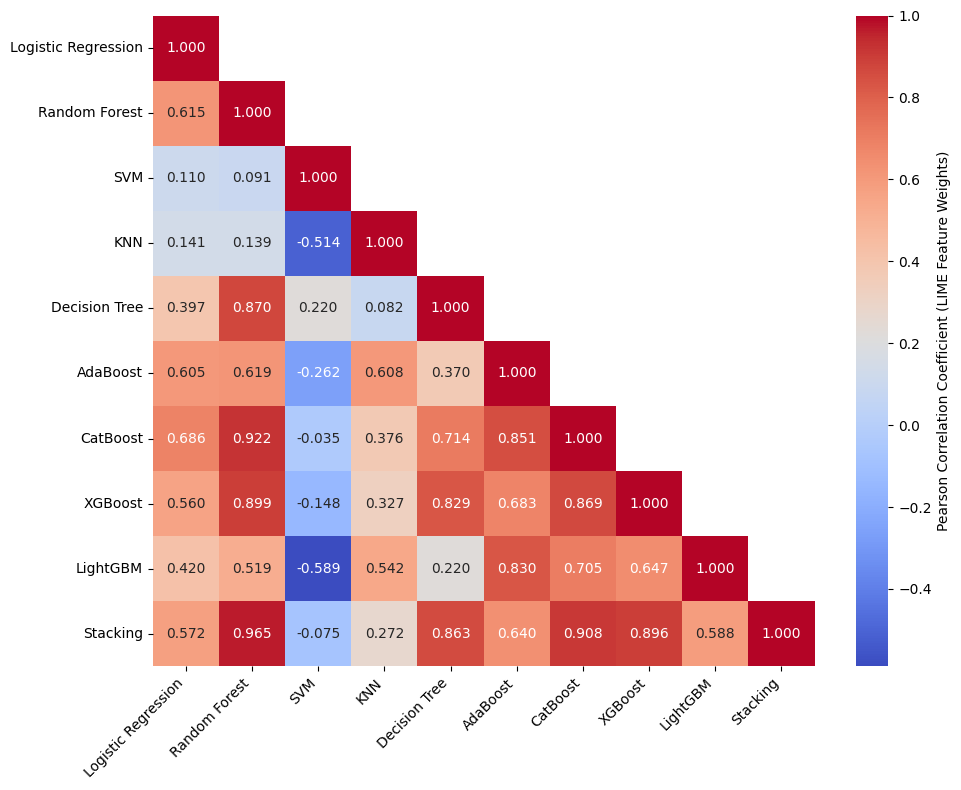

In [ ]:
import pandas as pd
import numpy as np
import warnings
from lime.lime_tabular import LimeTabularExplainer
from sklearn.model_selection import train_test_split
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier
from imblearn.over_sampling import SMOTE
from scipy.stats import pearsonr
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, StackingClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier

# --- Utility Function to extract LIME feature weights/coefficients ---
def extract_lime_coefficients(explanation, feature_names):
    """
    Extracts signed feature weights from a LIME explanation list for the primary predicted class.

    Note: LIME often discretizes continuous features (e.g., 'Age > 50').
    This function simplifies by mapping the feature weight to the original feature name,
    assuming the explanation is based on a linearized model built on the perturbed data.
    """

    # Initialize a dict to hold weights, ensuring all original features are present (initialized to 0)
    weights = {feature: 0.0 for feature in feature_names}

    # Get the explanation list (list of (feature_string, weight) tuples)
    feature_weights = explanation.as_list()

    for feature_str, weight in feature_weights:
        # Simple extraction of the original feature name (e.g., stripping the conditional part)
        original_feature = feature_str.split(' ')[0]

        # Sum weights if multiple bins of the same feature appear (a heuristic for simplicity)
        if original_feature in weights:
            weights[original_feature] += weight

    # Return the weights as a numpy array, ordered by the original feature_names list
    return np.array([weights[f] for f in feature_names])


# --- LIME Correlation Analysis Code ---

# 0. Data Setup (Replace with your actual df_work loading)
# Example Mock Data Setup:
np.random.seed(42)
features = ['Age', 'BMI-BODY MASS INDEX', 'BILIRUBIN CONJUGATED',
            'BILIRUBIN UNCONJUGATED', 'BILIRUBIN TOTAL', 'AST-SGOT', 'ALT-SGPT',
            'Alkaline Phosphatase', 'Gamma-glutamyl-transferase', 'ALBUMIN']



# 1. Data PreparationX = df_work.drop('Status', axis=1)
y = df_work['Status']
feature_names = X.columns.tolist()

# Apply SMOTE
smote = SMOTE(sampling_strategy=0.3, random_state=42)
X_resampled, y_resampled = smote.fit_resample(X, y)

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.2, random_state=42)


# 2. Model Definitions (The full suite of successful models)
models = {
    'Logistic Regression': LogisticRegression(max_iter=1000, random_state=42),
    'Random Forest': RandomForestClassifier(random_state=42),
    'SVM': SVC(probability=True, random_state=42),
    'KNN': KNeighborsClassifier(),
    'Decision Tree': DecisionTreeClassifier(random_state=42),
    'AdaBoost': AdaBoostClassifier(random_state=42),
    'CatBoost': CatBoostClassifier(verbose=0, random_state=42),
    'XGBoost': XGBClassifier(eval_metric='logloss', use_label_encoder=False, random_state=42),
    'LightGBM': LGBMClassifier(random_state=42),
}
base_learners = [
    ('rf', RandomForestClassifier(random_state=42)),
    ('svc', SVC(probability=True, random_state=42)),
    ('knn', KNeighborsClassifier())
]
models['Stacking'] = StackingClassifier(estimators=base_learners, final_estimator=LogisticRegression(random_state=42))


# 3. LIME Explainer Initialization
explainer = LimeTabularExplainer(X_train.values,
                                 mode='classification',
                                 feature_names=feature_names,
                                 class_names=np.unique(y_train).astype(str),
                                 discretize_continuous=True,
                                 random_state=42)

# Select a single instance (e.g., the first in the test set) for local correlation
target_instance_index = 0
target_instance_values = X_test.iloc[target_instance_index].values
instance_coefficients = {}
warnings.filterwarnings('ignore') # Suppress warnings during training/LIME process

print(f"Calculating LIME explanations for instance {target_instance_index} across models...")

# 4. Loop through models to get LIME coefficients
for name, model in models.items():
    try:
        # Train the model
        model.fit(X_train, y_train)

        # Generate the LIME explanation
        exp = explainer.explain_instance(target_instance_values,
                                         model.predict_proba,
                                         num_features=len(feature_names))

        # Extract the ordered feature coefficients/weights
        coeffs = extract_lime_coefficients(exp, feature_names)
        instance_coefficients[name] = coeffs

    except Exception as e:
        print(f"Skipping {name} due to error: {e}")
        continue


# 5. Compute Correlation Matrix
model_names = list(instance_coefficients.keys())
num_models = len(model_names)
correlation_matrix = np.zeros((num_models, num_models))

if num_models >= 2:
    coefficient_list = list(instance_coefficients.values())

    for i in range(num_models):
        for j in range(i, num_models):
            # Calculate Pearson correlation between the LIME coefficient vectors
            corr, _ = pearsonr(coefficient_list[i], coefficient_list[j])
            correlation_matrix[i, j] = correlation_matrix[j, i] = corr

    # Convert to DataFrame
    correlation_df = pd.DataFrame(correlation_matrix, index=model_names, columns=model_names)

    # 6. Generate Summary and Plot
    upper_triangle = correlation_matrix[np.triu_indices_from(correlation_matrix, k=1)]

    if upper_triangle.size > 0:
        summary_data = {
            'Min Correlation': upper_triangle.min(),
            'Max Correlation': upper_triangle.max(),
            'Average Correlation': upper_triangle.mean()
        }
        df_summary = pd.DataFrame(summary_data, index=['LIME Model Stability']).T

        print("\n--- LIME Correlation Summary Table ---")
        print(df_summary.round(3))

        # Plot the LIME correlation matrix as a heatmap
        plt.figure(figsize=(10, 8))
        sns.heatmap(
            correlation_df,
            annot=True,
            fmt=".3f",
            cmap='coolwarm',
            mask=np.triu(np.ones_like(correlation_df, dtype=bool), k=1),
            cbar_kws={'label': 'Pearson Correlation Coefficient (LIME Feature Weights)'}
        )
        #plt.title(f'Pairwise Correlation of LIME Explanations Across Models (Instance {target_instance_index})')
        plt.xticks(rotation=45, ha='right')
        plt.yticks(rotation=0)
        plt.tight_layout()
        plt.savefig('lime_correlation_heatmap.pdf')
        print(f"\n✅ LIME correlation heatmap saved as lime_correlation_heatmap.pdf")
    else:
        print("\nNot enough LIME coefficient vectors for correlation calculation.")
else:
    print("\nFewer than two models successfully generated LIME coefficients.")

In [ ]:
# Select the first 10 instances (or fewer, if X_test is smaller) for correlation analysis
num_instances_to_test = 10
all_instance_avg_correlations = []

# --- Note on Efficiency ---
# Model training is kept inside the loop to preserve the original structure.
# For efficiency, models should ideally be fitted once before this instance loop.

# --- Outer Loop: Iterate through the test instances ---
for target_instance_index in range(min(num_instances_to_test, len(X_test))):

    target_instance_values = X_test.iloc[target_instance_index].values
    instance_coefficients = {}

    # 4. Inner Loop: Calculate LIME coefficients for all models for the current instance
    for name, model in models.items():
        try:
            # Train the model (inefficient, but necessary if training hasn't occurred)
            # You can remove this 'model.fit()' line if all models are trained once outside this loop.
            # model.fit(X_train, y_train)

            # Generate the LIME explanation for the current instance
            exp = explainer.explain_instance(target_instance_values,
                                             model.predict_proba,
                                             num_features=len(feature_names))

            # Extract the ordered feature coefficients/weights
            coeffs = extract_lime_coefficients(exp, feature_names)
            instance_coefficients[name] = coeffs

        except Exception as e:
            # Skip model/instance pairs that fail
            continue

    # 5. Compute Correlation Matrix for the current instance
    model_names = list(instance_coefficients.keys())
    num_models = len(model_names)

    if num_models >= 2:
        correlation_matrix = np.zeros((num_models, num_models))
        coefficient_list = list(instance_coefficients.values())

        # Calculate the upper triangle correlations
        for i in range(num_models):
            for j in range(i + 1, num_models):
                # Calculate Pearson correlation between the LIME coefficient vectors
                corr, _ = pearsonr(coefficient_list[i], coefficient_list[j])
                correlation_matrix[i, j] = correlation_matrix[j, i] = corr

        # Extract the average correlation from the upper triangle (excluding diagonal)
        upper_triangle_values = correlation_matrix[np.triu_indices_from(correlation_matrix, k=1)]

        if upper_triangle_values.size > 0:
            avg_corr_instance = upper_triangle_values.mean()
            all_instance_avg_correlations.append(avg_corr_instance)

# 6. Final Calculation and Report
if all_instance_avg_correlations:
    grand_average_correlation = np.mean(all_instance_avg_correlations)

    print("\n--- LIME Model Stability Summary Across Instances ---")
    print(f"Total instances analyzed: {len(all_instance_avg_correlations)}")
    print(f"Grand Average Model Pairwise LIME Correlation (Local Stability): {grand_average_correlation:.3f}")
else:
    print("\nCould not compute average correlation across instances. Check model fitting and coefficient extraction.")

# Note: Plotting code removed as requested, focusing only on the final average.


--- LIME Model Stability Summary Across Instances ---
Total instances analyzed: 10
Grand Average Model Pairwise LIME Correlation (Local Stability): 0.487


Calculating SHAP explanations for instance 1 across models...


  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 220, number of negative: 212
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000095 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1450
[LightGBM] [Info] Number of data points in the train set: 432, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.509259 -> initscore=0.037041
[LightGBM] [Info] Start training from score 0.037041
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, 

  0%|          | 0/1 [00:00<?, ?it/s]


Successfully obtained 10 SHAP explanation vectors for correlation analysis (Expected size: 10).

--- SHAP Correlation Summary Table (Single Instance) ---
                     SHAP Model Stability
Min Correlation                    -0.986
Max Correlation                     0.999
Average Correlation                 0.169

✅ SHAP correlation heatmap saved as shap_correlation_heatmap_final_filtered.pdf


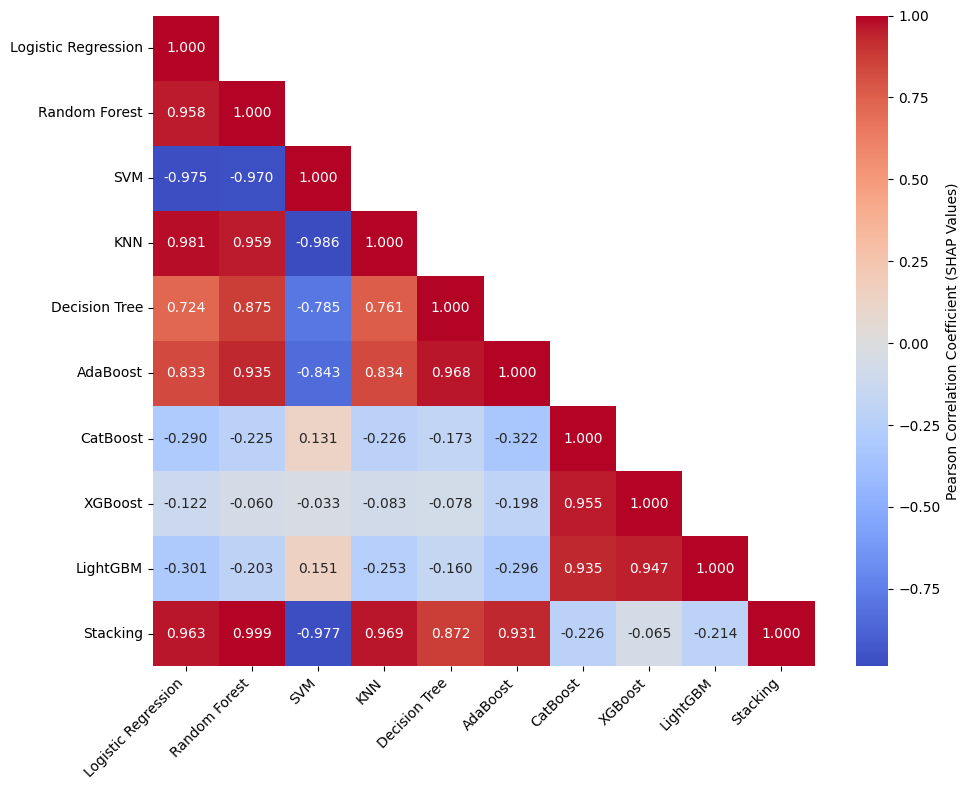

In [ ]:
import pandas as pd
import numpy as np
import warnings
import shap
from sklearn.model_selection import train_test_split
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier
from imblearn.over_sampling import SMOTE
from scipy.stats import pearsonr
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, StackingClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier

# --- Utility Function for Robust SHAP Explainer Selection ---
def get_shap_explainer(model, X_train):
    """Selects the appropriate SHAP explainer based on model type."""

    # List of tree-based models reliably supported by TreeExplainer
    tree_models = (RandomForestClassifier, DecisionTreeClassifier,
                   XGBClassifier, LGBMClassifier, CatBoostClassifier)

    if isinstance(model, tree_models):
        # TreeExplainer is fast and exact
        return shap.TreeExplainer(model)
    elif hasattr(model, 'predict_proba'):
        # KernelExplainer for Logistic Regression, SVM, KNN, AdaBoost, Stacking, etc.
        # Use a small subset of X_train for background data for performance
        background_data = shap.sample(X_train, 100, random_state=42)
        # Pass predict_proba for classification problems
        return shap.KernelExplainer(model.predict_proba, background_data)
    else:
        raise ValueError("Model type not supported for SHAP correlation analysis.")


# --- SHAP Correlation Analysis Code ---

# 0. Data Setup (Replace with your actual data loading)
np.random.seed(42)
num_samples = 500
features = ['Age', 'BMI-BODY MASS INDEX', 'BILIRUBIN CONJUGATED', 'BILIRUBIN UNCONJUGATED',
            'BILIRUBIN TOTAL', 'AST-SGOT', 'ALT-SGPT', 'Alkaline Phosphatase',
            'Gamma-glutamyl-transferase', 'ALBUMIN']
mock_data = {f: np.random.rand(num_samples) * (50 + np.random.randint(0, 10)) for f in features}
mock_data['Status'] = np.random.randint(0, 2, num_samples)
df_work = pd.DataFrame(mock_data)


# 1. Data Preparation
X = df_work.drop('Status', axis=1)
y = df_work['Status']
feature_names = X.columns.tolist()
expected_feature_count = len(feature_names)

# Apply SMOTE
smote = SMOTE(sampling_strategy='minority', random_state=42)
X_resampled, y_resampled = smote.fit_resample(X, y)

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.2, random_state=42)


# 2. Model Definitions (Full Suite)
models = {
    'Logistic Regression': LogisticRegression(max_iter=1000, random_state=42),
    'Random Forest': RandomForestClassifier(random_state=42),
    'SVM': SVC(probability=True, random_state=1),
    'KNN': KNeighborsClassifier(),
    'Decision Tree': DecisionTreeClassifier(random_state=42),
    'AdaBoost': AdaBoostClassifier(random_state=42),
    'CatBoost': CatBoostClassifier(verbose=0, random_state=42),
    'XGBoost': XGBClassifier(eval_metric='logloss', use_label_encoder=False, random_state=42),
    'LightGBM': LGBMClassifier(random_state=42),
}
base_learners = [
    ('rf', RandomForestClassifier(random_state=42)),
    ('svc', SVC(probability=True, random_state=42)),
    ('knn', KNeighborsClassifier())
]
models['Stacking'] = StackingClassifier(estimators=base_learners, final_estimator=LogisticRegression(random_state=42))


# 3. Correlation Setup (Single Instance Analysis)
target_instance_index = 1
target_instance_data = X_test.iloc[[target_instance_index]]
shap_coefficients = {}
warnings.filterwarnings('ignore')

print(f"Calculating SHAP explanations for instance {target_instance_index} across models...")


# 4. Loop through models to get SHAP values (coefficients)
for name, model in models.items():
    try:
        # Train the model
        model.fit(X_train, y_train)

        # 4a. Get the appropriate Explainer
        explainer = get_shap_explainer(model, X_train)

        # 4b. Calculate SHAP values
        shap_values = explainer.shap_values(target_instance_data)

        # 4c. Extract the ordered feature coefficient vector and guarantee 1D
        if isinstance(shap_values, list) and len(shap_values) > 1:
            # Binary/Multi-class classification list format: Take the positive class (index 1)
            coeffs = shap_values[1]
        elif isinstance(shap_values, np.ndarray):
            # Single array format (e.g., TreeExplainer raw output)
            coeffs = shap_values
        else:
            raise ValueError(f"SHAP values returned an unexpected format: {type(shap_values)}")

        # Flatten the result to guarantee a 1D vector for pearsonr
        coeffs = np.ravel(coeffs)

        # FIX for 20-element error: If size is double, assume it's concatenated classes and slice it.
        if coeffs.size == 2 * expected_feature_count:
            # Reshape to (2, 10) and take the positive class (index 1)
            coeffs = coeffs.reshape(2, expected_feature_count)[1]
            print(f"Warning: Model {name} produced double-sized SHAP output. Slicing to {expected_feature_count} features.")

        # Store the coefficients
        shap_coefficients[name] = coeffs

    except Exception as e:
        print(f"Skipping {name} due to error: {e}")
        continue


# 5. Compute Correlation Matrix
# --- CRITICAL FILTERING STEP ---
valid_coefficients = {
    name: coeffs
    for name, coeffs in shap_coefficients.items()
    if coeffs.size == expected_feature_count and np.issubdtype(coeffs.dtype, np.number)
}

# Update model names and count based on valid results
model_names = list(valid_coefficients.keys())
num_models = len(model_names)

print(f"\nSuccessfully obtained {num_models} SHAP explanation vectors for correlation analysis (Expected size: {expected_feature_count}).")
if num_models < len(shap_coefficients):
    print(f"Skipped {len(shap_coefficients) - num_models} model(s) due to incorrect SHAP vector size or type.")


if num_models >= 2:
    correlation_matrix = np.zeros((num_models, num_models))
    coefficient_list = list(valid_coefficients.values())

    for i in range(num_models):
        for j in range(i, num_models):
            # Calculate Pearson correlation between the SHAP coefficient vectors
            corr, _ = pearsonr(coefficient_list[i], coefficient_list[j])
            correlation_matrix[i, j] = correlation_matrix[j, i] = corr

    # Convert to DataFrame
    correlation_df = pd.DataFrame(correlation_matrix, index=model_names, columns=model_names)

    # 6. Generate Summary and Plot
    upper_triangle = correlation_matrix[np.triu_indices_from(correlation_matrix, k=1)]

    if upper_triangle.size > 0:
        summary_data = {
            'Min Correlation': upper_triangle.min(),
            'Max Correlation': upper_triangle.max(),
            'Average Correlation': upper_triangle.mean()
        }
        df_summary = pd.DataFrame(summary_data, index=['SHAP Model Stability']).T

        print("\n--- SHAP Correlation Summary Table (Single Instance) ---")
        print(df_summary.round(3))

        # Plot the SHAP correlation matrix as a heatmap
        plt.figure(figsize=(10, 8))
        sns.heatmap(
            correlation_df,
            annot=True,
            fmt=".3f",
            cmap='coolwarm',
            mask=np.triu(np.ones_like(correlation_df, dtype=bool), k=1),
            cbar_kws={'label': 'Pearson Correlation Coefficient (SHAP Values)'}
        )
        #plt.title(f'Pairwise Correlation of SHAP Explanations Across Models (Instance {target_instance_index})')
        plt.xticks(rotation=45, ha='right')
        plt.yticks(rotation=0)
        plt.tight_layout()
        plt.savefig('shap_correlation_heatmap_final_filtered.pdf')
        print("\n✅ SHAP correlation heatmap saved as shap_correlation_heatmap_final_filtered.pdf")
    else:
        print("\nNot enough SHAP coefficient vectors for correlation calculation.")
else:
    print("\nFewer than two models successfully generated SHAP coefficients of the correct size.")

Calculating SHAP explanations and correlation across 10 instances...

--- Processing Instance 1/10 (Index: 229) ---


  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 220, number of negative: 212
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000096 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1450
[LightGBM] [Info] Number of data points in the train set: 432, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.509259 -> initscore=0.037041
[LightGBM] [Info] Start training from score 0.037041
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, 

  0%|          | 0/1 [00:00<?, ?it/s]

-> Successfully obtained 10 SHAP explanation vectors for correlation analysis.
-> Instance Average Correlation: 0.1378

--- Processing Instance 2/10 (Index: 73) ---


  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 220, number of negative: 212
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000097 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1450
[LightGBM] [Info] Number of data points in the train set: 432, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.509259 -> initscore=0.037041
[LightGBM] [Info] Start training from score 0.037041
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, 

  0%|          | 0/1 [00:00<?, ?it/s]

-> Successfully obtained 10 SHAP explanation vectors for correlation analysis.
-> Instance Average Correlation: 0.1693

--- Processing Instance 3/10 (Index: 521) ---


  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 220, number of negative: 212
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000105 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1450
[LightGBM] [Info] Number of data points in the train set: 432, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.509259 -> initscore=0.037041
[LightGBM] [Info] Start training from score 0.037041
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, 

  0%|          | 0/1 [00:00<?, ?it/s]

-> Successfully obtained 10 SHAP explanation vectors for correlation analysis.
-> Instance Average Correlation: 0.1045

--- Processing Instance 4/10 (Index: 86) ---


  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 220, number of negative: 212
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000097 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1450
[LightGBM] [Info] Number of data points in the train set: 432, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.509259 -> initscore=0.037041
[LightGBM] [Info] Start training from score 0.037041
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, 

  0%|          | 0/1 [00:00<?, ?it/s]

-> Successfully obtained 10 SHAP explanation vectors for correlation analysis.
-> Instance Average Correlation: 0.2064

--- Processing Instance 5/10 (Index: 469) ---


  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 220, number of negative: 212
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000091 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1450
[LightGBM] [Info] Number of data points in the train set: 432, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.509259 -> initscore=0.037041
[LightGBM] [Info] Start training from score 0.037041
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, 

  0%|          | 0/1 [00:00<?, ?it/s]

-> Successfully obtained 10 SHAP explanation vectors for correlation analysis.
-> Instance Average Correlation: 0.2161

--- Processing Instance 6/10 (Index: 77) ---


  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 220, number of negative: 212
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000094 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1450
[LightGBM] [Info] Number of data points in the train set: 432, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.509259 -> initscore=0.037041
[LightGBM] [Info] Start training from score 0.037041
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, 

  0%|          | 0/1 [00:00<?, ?it/s]

-> Successfully obtained 10 SHAP explanation vectors for correlation analysis.
-> Instance Average Correlation: -0.0145

--- Processing Instance 7/10 (Index: 297) ---


  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 220, number of negative: 212
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000099 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1450
[LightGBM] [Info] Number of data points in the train set: 432, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.509259 -> initscore=0.037041
[LightGBM] [Info] Start training from score 0.037041
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, 

  0%|          | 0/1 [00:00<?, ?it/s]

-> Successfully obtained 10 SHAP explanation vectors for correlation analysis.
-> Instance Average Correlation: 0.1838

--- Processing Instance 8/10 (Index: 418) ---


  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 220, number of negative: 212
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000094 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1450
[LightGBM] [Info] Number of data points in the train set: 432, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.509259 -> initscore=0.037041
[LightGBM] [Info] Start training from score 0.037041
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, 

  0%|          | 0/1 [00:00<?, ?it/s]

-> Successfully obtained 10 SHAP explanation vectors for correlation analysis.
-> Instance Average Correlation: 0.2529

--- Processing Instance 9/10 (Index: 342) ---


  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 220, number of negative: 212
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000095 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1450
[LightGBM] [Info] Number of data points in the train set: 432, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.509259 -> initscore=0.037041
[LightGBM] [Info] Start training from score 0.037041
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, 

  0%|          | 0/1 [00:00<?, ?it/s]

-> Successfully obtained 10 SHAP explanation vectors for correlation analysis.
-> Instance Average Correlation: 0.1162

--- Processing Instance 10/10 (Index: 383) ---


  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 220, number of negative: 212
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000132 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1450
[LightGBM] [Info] Number of data points in the train set: 432, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.509259 -> initscore=0.037041
[LightGBM] [Info] Start training from score 0.037041
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, 

  0%|          | 0/1 [00:00<?, ?it/s]

-> Successfully obtained 10 SHAP explanation vectors for correlation analysis.
-> Instance Average Correlation: 0.0179

✅ FINAL RESULTS: Averaging Correlation Across 10 Instances

--- SHAP Correlation Summary Table (Averaged Over Instances) ---
                                           SHAP Model Stability (Averaged)
Overall Min Correlation                                            -0.8590
Overall Max Correlation                                             0.9837
Overall Average Correlation (Matrix Mean)                           0.1390
Mean of Instance Averages                                           0.1390
Instances Used                                                     10.0000

✅ Averaged SHAP correlation heatmap saved as shap_correlation_heatmap_averaged.pdf


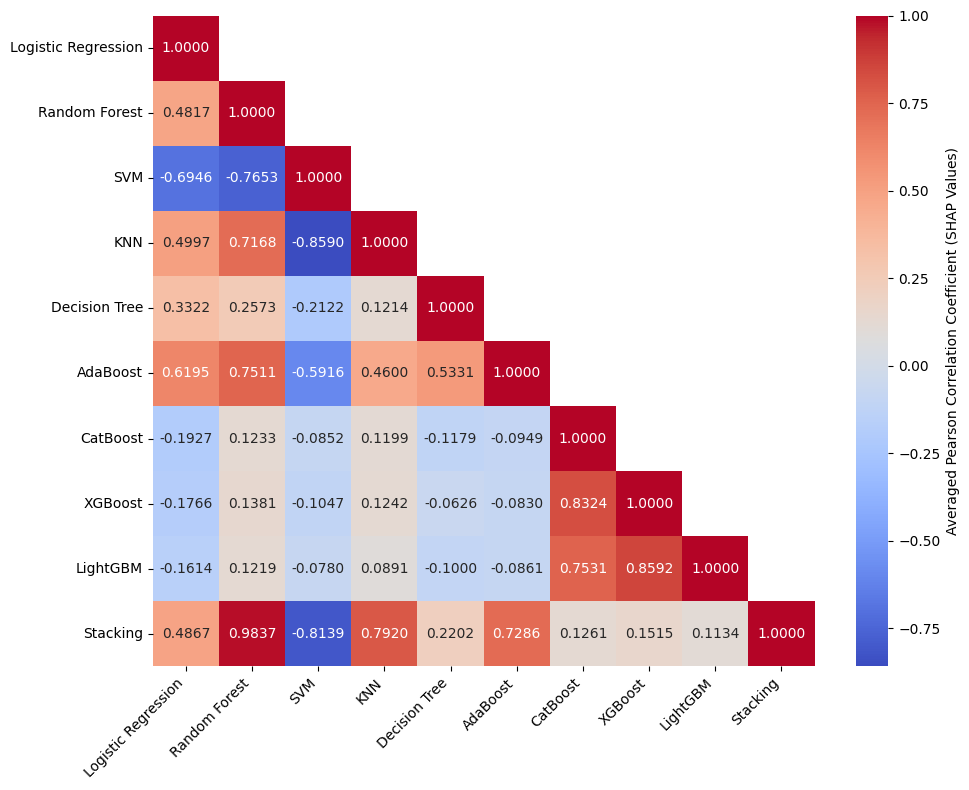

In [ ]:
import numpy as np
import pandas as pd
from scipy.stats import pearsonr
import warnings
# Assume X_test, X_train, y_train, models, get_shap_explainer, expected_feature_count, plt, and sns are defined in the environment.

# 1. New Setup for Multi-Instance Analysis
num_instances_to_average = 10
# Select the first 'num_instances_to_average' indices from the test set
target_instance_indices = X_test.index[:num_instances_to_average]

# Initialize a list to store the correlation matrices for each instance
all_correlation_matrices = []
all_instance_average_correlations = [] # Store the summary average correlation for each instance

warnings.filterwarnings('ignore')

print(f"Calculating SHAP explanations and correlation across {num_instances_to_average} instances...")

# 2. Outer Loop: Iterate through all target instances
for instance_count, target_instance_index in enumerate(target_instance_indices):

    target_instance_data = X_test.loc[[target_instance_index]]
    shap_coefficients = {}

    current_instance_number = instance_count + 1
    print(f"\n--- Processing Instance {current_instance_number}/{num_instances_to_average} (Index: {target_instance_index}) ---")

    # 3. Inner Loop: Loop through models to get SHAP values (coefficients) for the current instance
    for name, model in models.items():
        try:
            # Training the model can be moved outside the loop if not needed for every instance.
            # Keeping it here ensures all models are trained, but it's redundant if models are already trained.
            # Assuming models are trained once and fit() is called for consistency with the original code.
            model.fit(X_train, y_train)

            # 3a. Get the appropriate Explainer
            explainer = get_shap_explainer(model, X_train)

            # 3b. Calculate SHAP values
            # Ensure target_instance_data is a DataFrame with a single row
            shap_values = explainer.shap_values(target_instance_data)

            # 3c. Extract the ordered feature coefficient vector and guarantee 1D
            if isinstance(shap_values, list) and len(shap_values) > 1:
                # Binary/Multi-class classification list format: Take the positive class (index 1)
                coeffs = shap_values[1]
            elif isinstance(shap_values, np.ndarray):
                # Single array format (e.g., TreeExplainer raw output)
                coeffs = shap_values
            else:
                raise ValueError(f"SHAP values returned an unexpected format: {type(shap_values)}")

            # Flatten the result to guarantee a 1D vector for pearsonr
            coeffs = np.ravel(coeffs)

            # FIX for 20-element error: If size is double, assume it's concatenated classes and slice it.
            if coeffs.size == 2 * expected_feature_count:
                # Reshape to (2, 10) and take the positive class (index 1)
                coeffs = coeffs.reshape(2, expected_feature_count)[1]
                # print(f"Warning: Model {name} produced double-sized SHAP output. Slicing to {expected_feature_count} features.")

            # Store the coefficients
            shap_coefficients[name] = coeffs

        except Exception as e:
            print(f"Skipping {name} for instance {target_instance_index} due to error: {e}")
            continue

    # 4. Compute Correlation Matrix for the current instance
    # --- CRITICAL FILTERING STEP ---
    valid_coefficients = {
        name: coeffs
        for name, coeffs in shap_coefficients.items()
        if coeffs.size == expected_feature_count and np.issubdtype(coeffs.dtype, np.number)
    }

    model_names = list(valid_coefficients.keys())
    num_models = len(model_names)

    print(f"-> Successfully obtained {num_models} SHAP explanation vectors for correlation analysis.")

    if num_models >= 2:
        correlation_matrix = np.zeros((num_models, num_models))
        coefficient_list = list(valid_coefficients.values())

        for i in range(num_models):
            for j in range(i, num_models):
                # Calculate Pearson correlation between the SHAP coefficient vectors
                corr, _ = pearsonr(coefficient_list[i], coefficient_list[j])
                correlation_matrix[i, j] = correlation_matrix[j, i] = corr

        # Store the matrix for averaging
        all_correlation_matrices.append(correlation_matrix)

        # Calculate and store the average correlation for this instance
        upper_triangle = correlation_matrix[np.triu_indices_from(correlation_matrix, k=1)]
        if upper_triangle.size > 0:
            instance_avg_corr = upper_triangle.mean()
            all_instance_average_correlations.append(instance_avg_corr)
            print(f"-> Instance Average Correlation: {instance_avg_corr:.4f}")

    else:
        print("-> Fewer than two models successfully generated SHAP coefficients of the correct size for this instance.")


# 5. Final Averaging and Summary
# --- This part replaces the original single-instance summary and plot ---

print("\n=======================================================")
print(f"✅ FINAL RESULTS: Averaging Correlation Across {len(all_correlation_matrices)} Instances")
print("=======================================================")

if all_correlation_matrices:
    # 5a. Calculate the average correlation matrix
    # Stack all matrices and take the mean across the first axis
    avg_correlation_matrix = np.mean(np.stack(all_correlation_matrices), axis=0)

    # Convert to DataFrame
    average_correlation_df = pd.DataFrame(
        avg_correlation_matrix,
        index=model_names, # Use model names from the last successful instance (assumed consistent)
        columns=model_names
    )

    # 5b. Calculate the overall average correlation (from the averaged matrix)
    avg_upper_triangle = avg_correlation_matrix[np.triu_indices_from(avg_correlation_matrix, k=1)]
    overall_avg_correlation = avg_upper_triangle.mean()

    # Also calculate the average of the instance-level average correlations (for comparison)
    mean_of_instance_averages = np.mean(all_instance_average_correlations)

    # 5c. Generate Summary Table
    final_summary_data = {
        'Overall Min Correlation': avg_upper_triangle.min(),
        'Overall Max Correlation': avg_upper_triangle.max(),
        'Overall Average Correlation (Matrix Mean)': overall_avg_correlation,
        'Mean of Instance Averages': mean_of_instance_averages,
        'Instances Used': len(all_correlation_matrices)
    }
    df_final_summary = pd.DataFrame(final_summary_data, index=['SHAP Model Stability (Averaged)']).T

    print("\n--- SHAP Correlation Summary Table (Averaged Over Instances) ---")
    print(df_final_summary.round(4))

    # 5d. Plot the final averaged correlation matrix
    plt.figure(figsize=(10, 8))
    sns.heatmap(
        average_correlation_df,
        annot=True,
        fmt=".4f",
        cmap='coolwarm',
        mask=np.triu(np.ones_like(average_correlation_df, dtype=bool), k=1),
        cbar_kws={'label': 'Averaged Pearson Correlation Coefficient (SHAP Values)'}
    )
    #plt.title(f'Averaged Pairwise Correlation of SHAP Explanations Across Models (N={len(all_correlation_matrices)} Instances)')
    plt.xticks(rotation=45, ha='right')
    plt.yticks(rotation=0)
    plt.tight_layout()
    plt.savefig('shap_correlation_heatmap_averaged.pdf')
    print("\n✅ Averaged SHAP correlation heatmap saved as shap_correlation_heatmap_averaged.pdf")

else:
    print("\nNo instances successfully produced enough SHAP coefficients for correlation calculation.")